In [1]:
import base64
import glob
from io import BytesIO
import os
import re

from bokeh.embed import file_html
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.plotting import figure, show, output_notebook
from bokeh.resources import CDN

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import umap

output_notebook()

Loading BokehJS ...

## Loading Data

In [2]:
pokemon_df = pd.read_csv("../data/raw/pokemon/pokemon_alopez247.csv", index_col=0)
pokemon_dm_gower = pd.read_csv("../data/processed/pokemon_dm_gower.csv", sep=",", index_col=0)
pokemon_dm_gower_cat = pd.read_csv("../data/processed/pokemon_dm_gower_only_categorical.csv", sep=",", index_col=0)
pokemon_df = pokemon_df.reset_index(drop=True)
for col in pokemon_df.columns:
    if pokemon_df[col].dtype == 'bool':
        pokemon_df[col] = pokemon_df[col].astype(str)
pokemon_df.head()

,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,...,Color,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style
0,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,...,Green,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped
1,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,...,Green,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped
2,Venusaur,Grass,Poison,525,80,82,83,100,100,80,...,Green,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped
3,Charmander,Fire,NaN,309,39,52,43,60,50,65,...,Red,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed
4,Charmeleon,Fire,NaN,405,58,64,58,80,65,80,...,Red,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed


In [3]:
def fill_type2(row):
    if str(row["Type_2"]) == 'nan':
        return row["Type_1"]
    else:
        return row["Type_2"]
    
def fill_egg_group2(row):
    if str(row["Egg_Group_2"]) == 'nan':
        return row["Egg_Group_1"]
    else:
        return row["Egg_Group_2"]
    
pokemon_df["Type_2"] = pokemon_df.apply(fill_type2, 1)
pokemon_df["Egg_Group_2"] = pokemon_df.apply(fill_egg_group2, 1)
pokemon_df.head()

,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,...,Color,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style
0,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,...,Green,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped
1,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,...,Green,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped
2,Venusaur,Grass,Poison,525,80,82,83,100,100,80,...,Green,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped
3,Charmander,Fire,Fire,309,39,52,43,60,50,65,...,Red,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed
4,Charmeleon,Fire,Fire,405,58,64,58,80,65,80,...,Red,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed


In [4]:
pokemon_df.columns

Index(['Name', 'Type_1', 'Type_2', 'Total', 'HP', 'Attack', 'Defense',
       'Sp_Atk', 'Sp_Def', 'Speed', 'Generation', 'isLegendary', 'Color',
       'hasGender', 'Pr_Male', 'Egg_Group_1', 'Egg_Group_2',
       'hasMegaEvolution', 'Height_m', 'Weight_kg', 'Catch_Rate',
       'Body_Style'],
      dtype='object')

## Functions

In [5]:
def embeddable_image(data):
    """Get image to embed for bokeh plot"""
    # adapted from umap documentation
    buffer = BytesIO()
    data.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

In [6]:
def plot_bokeh(umap_results, title, name=None, location=None, **kwargs):
    plot_df = pd.DataFrame(umap_results)
    plot_df = plot_df.join(pokemon_df)
    plot_df.rename(columns={0:'x', 1:'y'}, inplace=True)

    datasource = ColumnDataSource(plot_df)

    plot_figure = figure(
        title=title,
        plot_width=600,
        plot_height=600,
        tools=('pan, wheel_zoom, reset')
    )

    plot_figure.add_tools(HoverTool(tooltips="""
    <div>
        <div>
            <img src='@img' style='float: left; margin: 5px 5px 5px 5px'/>
        </div>
        <div>
            <span style='font-size: 16px; color: #224499'>Pokemon:</span>
            <span style='font-size: 18px'>@Name</span>
        </div>
    </div>
    """))

    plot_figure.circle(
        'x',
        'y',
        source=datasource,
        **kwargs,
    )
    plot_figure.title.text_font_size = '14pt'
    show(plot_figure)

    if name is not None:
        save_to_html(plot_figure, name, location)

In [7]:
def save_to_html(plot, name, location):
    html = file_html(plot, CDN, name)
    with open(location, "w+") as f:
        f.write(html) 

## Load Images

In [8]:
pokemon_url = '../data/raw/pokemon/imgs/*Generation/*'
img_files = glob.glob(pokemon_url)
img_files = [x for x in img_files if "-Mega" not in x]
ids = [str(x).zfill(3) for x in range(1, pokemon_df.shape[0]+1)]
img_files_new = list()
for this_id in ids:
    first_img = [x for x in img_files if this_id in x][0]
    img_files_new.append(first_img)
img_files_new.sort()

In [9]:
imgs = [Image.open(x) for x in img_files_new]
size = (64, 64)
new_imgs = list()
for img in imgs:
    img.thumbnail(size)
    img.load() # required for png.split()

    background = Image.new("RGB", img.size, (255, 255, 255))
    background.paste(img, mask=img.split()[3]) # 3 is the alpha channel
    new_imgs.append(background)

In [10]:
embedding_imgs = list(map(embeddable_image, new_imgs))
embedding_imgs = embedding_imgs[:pokemon_df.shape[0]]
pokemon_df['img'] = embedding_imgs

## Only Numeric Data

In [11]:
pokemon_df_only_num = pokemon_df[['Total', 'HP', 'Attack', 'Defense', 
                                  'Sp_Atk', 'Sp_Def', 'Speed', 'Height_m', 
                                  'Weight_kg', 'Catch_Rate']].reset_index(drop=True)
pokemon_df_only_num.head()

,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Height_m,Weight_kg,Catch_Rate
0,318,45,49,49,65,65,45,0.71,6.9,45
1,405,60,62,63,80,80,60,0.99,13.0,45
2,525,80,82,83,100,100,80,2.01,100.0,45
3,309,39,52,43,60,50,65,0.61,8.5,45
4,405,58,64,58,80,65,80,1.09,19.0,45


In [12]:
reducer_only_num = umap.UMAP(min_dist=0.4, n_neighbors=8, random_state=42)
embedding_only_num = reducer_only_num.fit_transform(pokemon_df_only_num)
plot_bokeh(
    embedding_only_num, 
    "Only Numeric Features", 
    "pokemon_only_num",
    "../html/pokemon_only_num.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='red',
)

## Only Categorical Features

In [13]:
reducer_only_cat = umap.UMAP(metric="precomputed", min_dist=0.4, n_neighbors=8, random_state=42)
embedding_only_cat = reducer_only_cat.fit_transform(pokemon_dm_gower_cat)
plot_bokeh(
    embedding_only_cat, 
    "Only Categorical Features", 
    "pokemon_only_cat",
    "../html/pokemon_only_cat.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='blue',
)

## Both Numeric and Categorical Features

In [14]:
reducer_gower = umap.UMAP(metric="precomputed", min_dist=0.4, n_neighbors=8, random_state=42)
embedding_gower = reducer_gower.fit_transform(pokemon_dm_gower)
plot_bokeh(
    embedding_gower, 
    "Both Numeric and Categorical Features", 
    "pokemon_gower",
    "../html/pokemon_gower.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='yellow',
)

## Plotting by Type

In [15]:
gower_umap_df = pd.DataFrame(embedding_gower).join(pokemon_df)
gower_umap_df.rename(columns={0: 'x', 1: 'y'}, inplace=True)
gower_umap_df.head()

,x,y,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,...,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style,img
0,4.812720,-0.210294,Bulbasaur,Grass,Poison,318,45,49,49,65,...,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
1,4.740457,-0.579724,Ivysaur,Grass,Poison,405,60,62,63,80,...,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
2,4.421638,-0.347810,Venusaur,Grass,Poison,525,80,82,83,100,...,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
3,-0.212071,-0.230350,Charmander,Fire,Fire,309,39,52,43,60,...,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
4,-0.200168,-0.053723,Charmeleon,Fire,Fire,405,58,64,58,80,...,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."


In [16]:
all_types = gower_umap_df["Type_1"].unique()
type_dict = {"Fire": "#F08030", 
             "Grass": "#78C850", 
             "Water": "#6890F0", 
             "Bug": "#a8b820",
             "Normal": "#a8a878",
             "Poison": "#A040A0",
             "Electric": "#F8D030",
             "Ground": "#E0C068",
             "Dark": "#705848",
             "Psychic": "#F85888",
             "Dragon": "#7038F8",
             "Flying": "#A890F0",
             "Fairy": "#EE99AC",
             "Fighting": "#C03028",
             "Ghost": "#705898",
             "Rock": "#B8A038",
             "Steel": "#B8B8D0",
             "Ice": "#98D8D8",
            }

def type_color(row, pkmn_type):
    if row["Type_2"] == pkmn_type:
        return pkmn_type
    if row["Type_1"] == pkmn_type:
        return pkmn_type
    else:
        return "other"

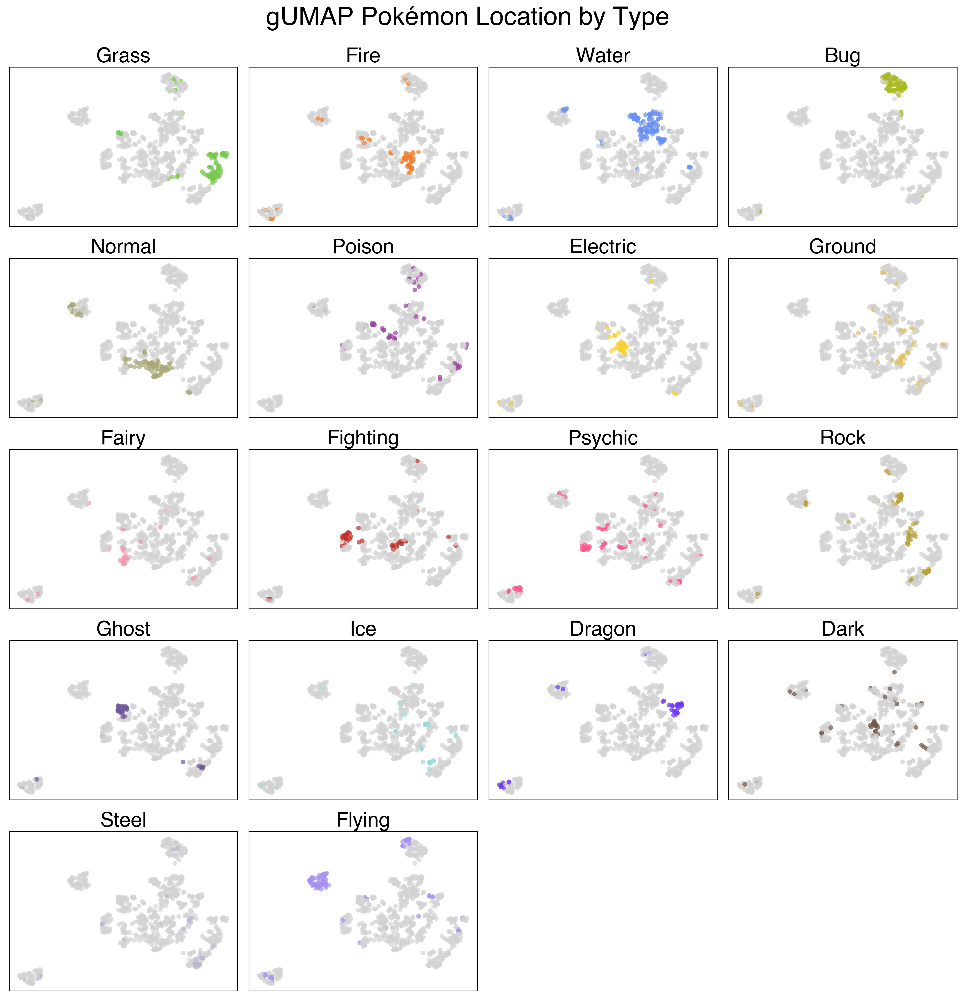

In [17]:
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(5, 4, figsize=(20, 20), dpi=300)
plt.subplots_adjust(wspace=0.05, hspace=0.2)

for i, this_type in enumerate(all_types):
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    color_vals = df_copy.apply(type_color, 1, pkmn_type=this_type)
    df_copy["color"] = color_vals
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=30,
        hue="color",
        palette={this_type: type_dict[this_type], "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_title(this_type, fontsize=24)

plt.suptitle("gUMAP Pokémon Location by Type", fontsize=30, y=0.93)

i += 1
while i < 20:
    axes.flat[i].set_visible(False)
    i += 1

plt.savefig("../figures/gUMAP_pokemon_location_by_type.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Stats

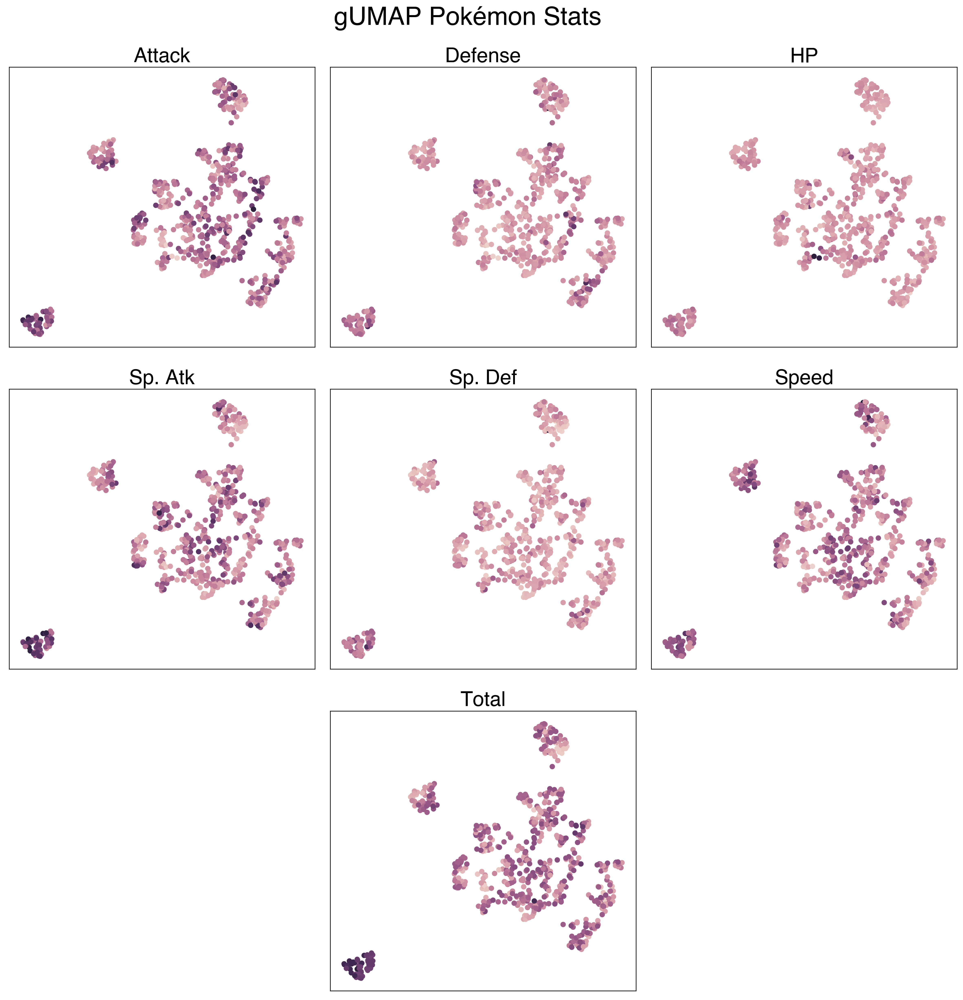

In [18]:
stats = ["Attack", "Defense", "HP", "Sp_Atk", "Sp_Def", "Speed", "Total"]
    
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 3, figsize=(20, 20), dpi=300)
plt.subplots_adjust(wspace=0.05, hspace=0.15)

for i in [0, 2]:
    axes[2, i].set_visible(False)

for i, this_stat in enumerate(stats):       
    if i == 6:
        ax = axes[2, 1]
    else:
        ax = axes.flat[i]
    
    sns.scatterplot(
        data=gower_umap_df,
        x="x",
        y="y",
        s=40,
        hue=this_stat,
        cmap=sns.cubehelix_palette(as_cmap=True),
        legend=False,
        edgecolor="black",
        linewidth=0,
        #alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_title(this_stat.replace("_", ". "), fontsize=24)

plt.suptitle("gUMAP Pokémon Stats", fontsize=30, y=0.93)
plt.savefig("../figures/gUMAP_pokemon_stats.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Height and Weight

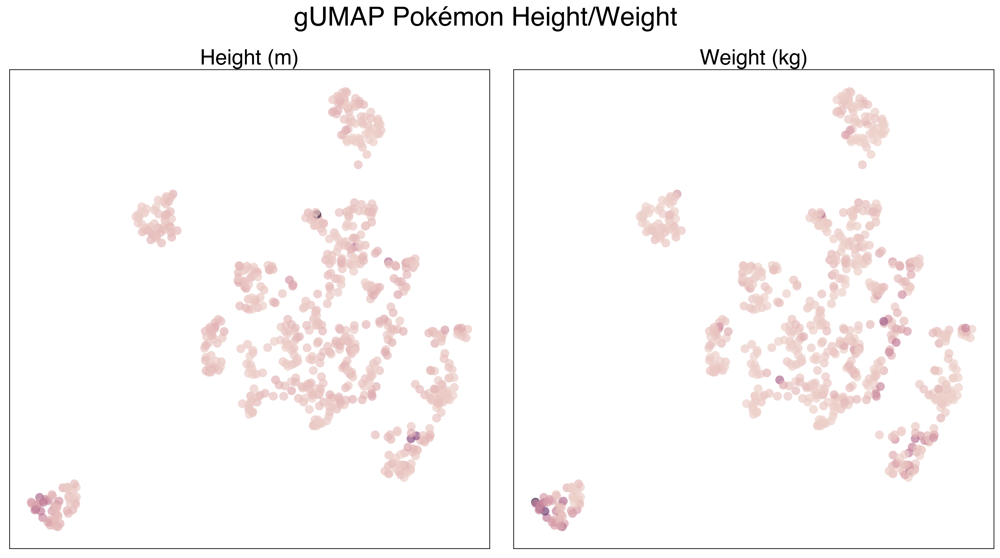

In [19]:
metrics = ["Height_m", "Weight_kg"]
    
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(1, 2, figsize=(20, 10), dpi=300)
plt.subplots_adjust(wspace=0.05, hspace=0.15)

for i, this_metric in enumerate(metrics):       
    ax = axes.flat[i]
    
    sns.scatterplot(
        data=gower_umap_df,
        x="x",
        y="y",
        s=100,
        hue=this_metric,
        cmap=sns.cubehelix_palette(as_cmap=True),
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    title = "{} ({})".format(*re.search("([A-Za-z]*)_([a-z]*)", this_metric).groups())
    ax.set_title(title, fontsize=24)

plt.suptitle("gUMAP Pokémon Height/Weight", fontsize=30, y=0.98)
plt.savefig("../figures/gUMAP_pokemon_height_weight.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Egg Group

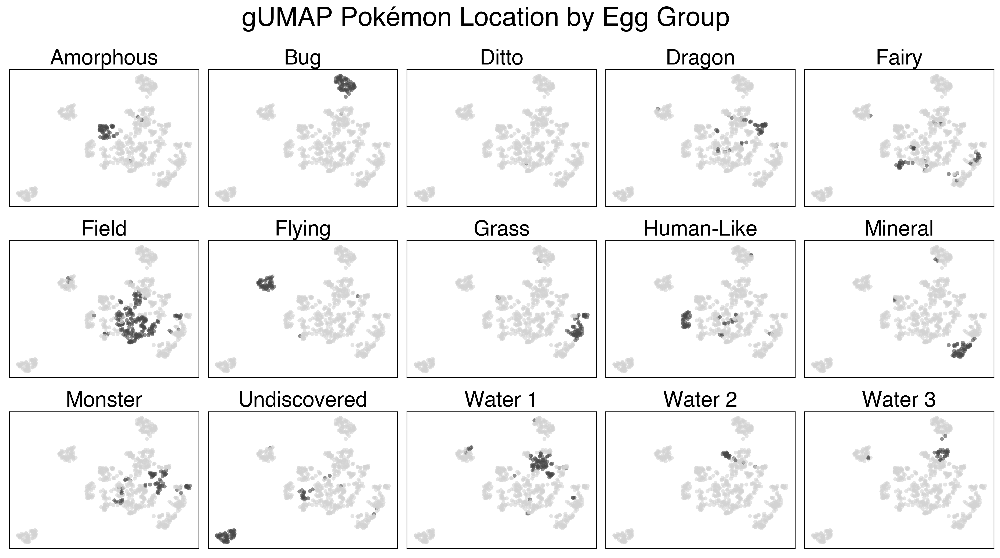

In [20]:
all_egg_groups = set(gower_umap_df["Egg_Group_1"]) & set(gower_umap_df["Egg_Group_2"])
all_egg_groups = sorted(all_egg_groups)

def get_egg_group(row, egg_group):
    if row["Egg_Group_1"] == egg_group:
        return egg_group
    elif row["Egg_Group_2"] == egg_group:
        return egg_group
    else:
        return "other"

plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 5, figsize=(20, 10), dpi=300)
plt.subplots_adjust(wspace=0.05, hspace=0.25)

for i, this_egg_group in enumerate(all_egg_groups):       
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    df_copy["color"] = df_copy.apply(get_egg_group, 1, egg_group=this_egg_group)
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=20,
        hue="color",
        palette={this_egg_group: "#484848", "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.6,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    #title = "{} ({})".format(*re.search("([A-Za-z]*)_([a-z]*)", this_metric).groups())
    ax.set_title(this_egg_group.replace("_", " "), fontsize=24)

plt.suptitle("gUMAP Pokémon Location by Egg Group", fontsize=30, y=0.98)
plt.savefig("../figures/gUMAP_pokemon_location_by_egg_group.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Body Style

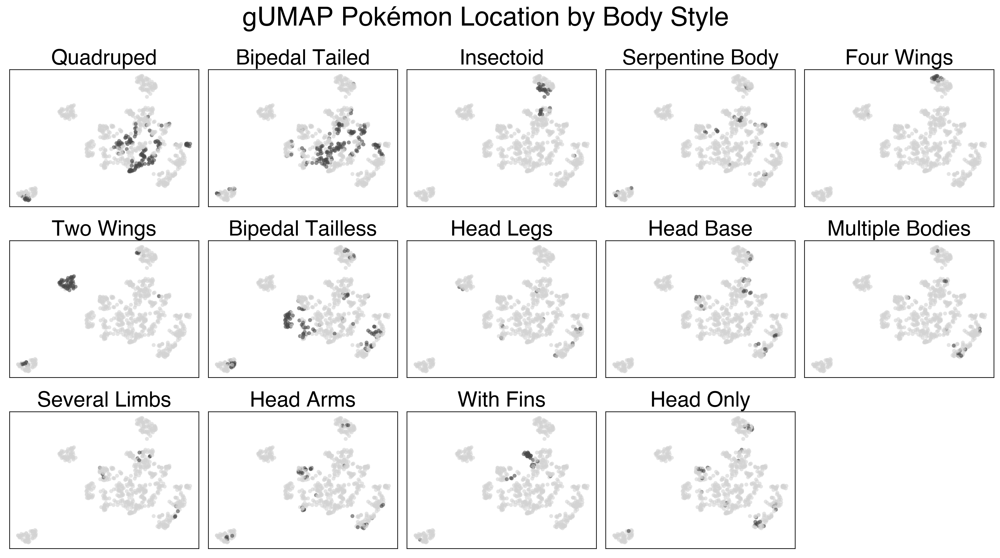

In [21]:
all_body_styles = gower_umap_df["Body_Style"].unique()

plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 5, figsize=(20, 10), dpi=300)
plt.subplots_adjust(wspace=0.05, hspace=0.25)

for i, this_body_style in enumerate(all_body_styles):       
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    df_copy["color"] = df_copy.apply(lambda x: this_body_style if x["Body_Style"] == this_body_style else "other", 1)
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=20,
        hue="color",
        palette={this_body_style: "#484848", "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.6,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    #title = "{} ({})".format(*re.search("([A-Za-z]*)_([a-z]*)", this_metric).groups())
    ax.set_title(this_body_style.replace("_", " ").title(), fontsize=24)

axes[-1][-1].set_visible(False)
plt.suptitle("gUMAP Pokémon Location by Body Style", fontsize=30, y=0.98)
plt.savefig("../figures/gUMAP_pokemon_location_by_body_style.png", dpi=300, bbox_inches="tight")
plt.show()